## Flowpipe

In [1]:
using ReachabilityAnalysis, Plots

In [2]:
@taylorize function seir2!(du,u,p,t)
  S, E, I, R, α, β, γ = u

  βIS = β * (I * S)
  αE = α*E
  γI = γ*I

  du[1] = -βIS      # dS
  du[2] = βIS - αE  # dE
  du[3] = -γI + αE  # dI
  du[4] = γI        # dR

  # uncertain parameters
  local zerou = zero(u[1])
  du[5] = zerou
  du[6] = zerou
  du[7] = zerou
end

E₀ = 1e-4
u₀ = [1-E₀, E₀, 0, 0]
param_error = 0.01
α = 0.2 ± param_error
β = 1.0 ± 0.0
γ = 0.5 ± param_error
p = [α, β, γ]
X0 = IntervalBox(vcat(u₀, p));
prob = @ivp(x' = seir2!(x), dim=7, x(0) ∈ X0);

In [3]:
@time sol = solve(prob, tspan=(0.0, 200.0), alg=TMJets(orderT=7, orderQ=1));
solz = overapproximate(sol, Zonotope);

 15.693078 seconds (42.92 M allocations: 2.396 GiB, 5.00% gc time)


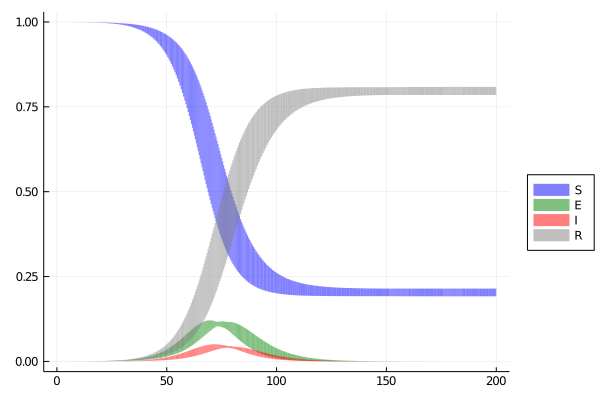

In [4]:
LazySets.set_ztol(Float64, 1e-13)
fig = plot(legend=:outerright)
plot!(fig, solz, vars=(0, 1), color=:blue, lw=0.0, lab="S")
plot!(fig, solz, vars=(0, 2), color=:green, lw=0.0, lab="E")
plot!(fig, solz, vars=(0, 3), color=:red, lw=0.0, lab="I")
plot!(solz, vars=(0, 4), color=:grey, lw=0.0, lab="R")

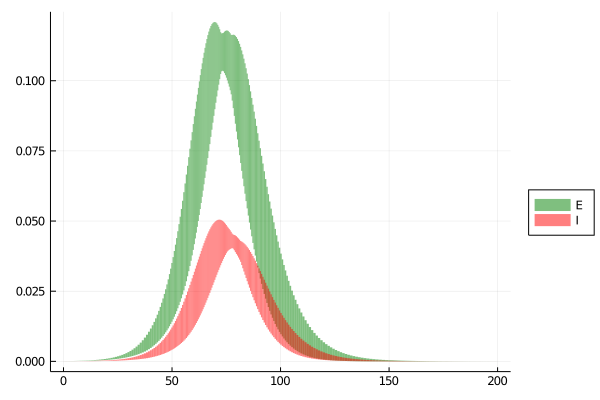

In [35]:
fig = plot(legend=:outerright)
plot!(fig, solz, vars=(0, 2), color=:green, lw=0.0, lab="E")
plot!(fig, solz, vars=(0, 3), color=:red, lw=0.0, lab="I")

## Computing trajectories

In [6]:
using Distributions, DifferentialEquations

In [8]:
function seir!(du,u,p,t)
  S, E, I, R = u
  α, β, γ = p

  βIS = β * (I * S)
  αE = α*E
  γI = γ*I

  du[1] = -βIS      # dS
  du[2] = βIS - αE  # dE
  du[3] = -γI + αE  # dI
  du[4] = γI        # dR
end

seir! (generic function with 1 method)

In [27]:
E₀ = 1e-4
u₀ = [1-E₀, E₀, 0, 0]

α = 0.2
β = 1.0
γ = 0.5

Δα = 0.01
Δβ = 0.0
Δγ = 0.01

dα = Uniform(α - Δα, α + Δα)
dβ = 1.0 # Uniform(β - Δβ, β + Δβ)
dγ = Uniform(γ - Δγ, γ + Δγ);

In [54]:
soltot = []
NSIM = 1000

for k in 1:NSIM
    # u₀ is held constant
    p = [rand(dα), 1.0, rand(dγ)]
    odeprob = ODEProblem(seir!, u₀, (0.0, 200.0), p)
    sol = DifferentialEquations.solve(odeprob, alg=Tsit5())
    push!(soltot, sol)
end

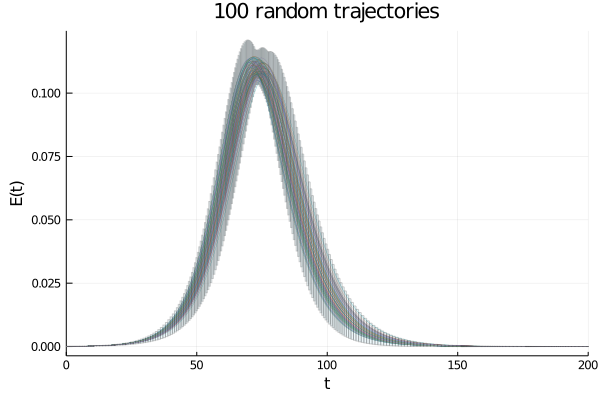

In [52]:
fig_E_100 = plot(xlab="time", ylab="E(t)", title="$NSIM random trajectories")
[plot!(fig_E_100, soltot[i], vars=(0, 2), lab="", lw=0.2) for i in 1:NSIM]
plot!(fig_E_100, solz, alpha=.2, vars=(0, 2), color=:lightblue)

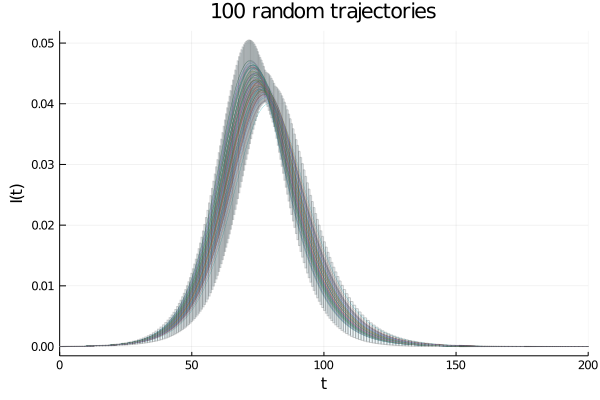

In [53]:
fig_I_100 = plot(xlab="time", ylab="I(t)", title="$NSIM random trajectories")
[plot!(fig_I_100, soltot[i], vars=(0, 3), lab="", lw=0.2) for i in 1:NSIM]
plot!(fig_I_100, solz, alpha=.2, vars=(0, 3), color=:lightblue)

In [55]:
fig_E_1000 = plot(xlab="time", ylab="E(t)", title="$NSIM random trajectories")
[plot!(fig_E_1000, soltot[i], vars=(0, 2), lab="", lw=0.2) for i in 1:NSIM]
plot!(fig_E_1000, solz, alpha=.2, vars=(0, 2), color=:lightblue)

In [57]:
fig_I_1000 = plot(xlab="time", ylab="I(t)", title="$NSIM random trajectories")
[plot!(fig_I_1000, soltot[i], vars=(0, 3), lab="", lw=0.2) for i in 1:NSIM]
plot!(fig_I_1000, solz, alpha=.2, vars=(0, 3), color=:lightblue)